## Basic Equations
This notebook presents a finite element code for the 1D elastic wave equation. Additionally, a solution using finite difference scheme is given for comparison.

The problem of solving the wave equation

\begin{equation}
\rho(x) \partial_t^2 u(x,t) = \partial_x (\mu(x) \partial_x u(x,t)) + f(x,t)
\end{equation}

using the finite element method is done after a series of steps performed on the above equation.

1) We first obtain a weak form of the wave equation by integrating over the entire physical domain $D$ and at the same time multiplying by some basis $\varphi_{i}$.

2) Integration by parts and implementation of the stress-free boundary condition is performed.

3) We approximate our unknown displacement field $u(x, t)$ by a sum over space-dependent basis functions $\varphi_i$ weighted by time-dependent coefficients $u_i(t)$.

\begin{equation}
u(x,t) \ \approx \ \overline{u}(x,t) \ = \ \sum_{i=1}^{n} u_i(t) \ \varphi_i(x)
\end{equation}

4) Utilize the same basis functions used to expand $u(x, t)$ as test functions in the weak form, this is the Galerkin principle.

5) We can turn the continuous weak form into a system of linear equations by considering the approximated displacement field.

\begin{equation}
\mathbf{M}^T\partial_t^2 \mathbf{u} + \mathbf{K}^T\mathbf{u} = \mathbf{f}
\end{equation}

6) For the second time-derivative, we use a standard finite-difference approximation. Finally, we arrive at the explicit time extrapolation scheme.

\begin{equation}
\mathbf{u}(t + dt) = dt^2 (\mathbf{M}^T)^{-1}[\mathbf{f} - \mathbf{K}^T\mathbf{u}] + 2\mathbf{u} - \mathbf{u}(t-dt).
\end{equation}

where $\mathbf{M}$ is known as the mass matrix, and $\mathbf{K}$ the stiffness matrix.

7) As interpolating functions, we choose interpolants such that $\varphi_{i}(x_{i}) = 1$ and zero elsewhere. Then, we transform the space coordinate into a local system. According to $\xi = x − x_{i}$ and $h_{i} = x_{i+1} − x_{i}$, we have:

<p style="width:35%;float:right;padding-left:50px">
<img src=fig_fe_basis_h.png>
<span style="font-size:smaller">
</span>
</p>

\begin{equation}
 \varphi_{i}(\xi) =
  \begin{cases}
    \frac{\xi}{h_{i-1}} + 1  & \quad \text{if} \quad -h_{i-1} \le \xi \le 0\\
    1 + \frac{\xi}{h_{i}}    & \quad \text{if} \quad 0 \le \xi \le h_{i}\\
    0  & \quad elsewhere\\
  \end{cases}
\end{equation}

with the corresponding derivatives

\begin{equation}
 \partial_{\xi}\varphi_{i}(\xi) =
  \begin{cases}
    \frac{1}{h_{i-1}}  & \quad \text{if} \quad -h_{i-1} \le \xi \le 0\\
   -\frac{1}{h_{i}}    & \quad \text{if} \quad 0 \le \xi \le h_{i}\\
    0  & \quad elsewhere\\
  \end{cases}
\end{equation}

The figure on the left-hand side illustrates the shape of $\varphi_{i}(\xi)$ and $\partial_{\xi}\varphi_{i}(\xi)$ with varying $h$.

Code implementation starts with the initialization of a particular setup of our problem. Then, we define the source that introduces perturbations following by initialization of the mass and stiffness matrices. Finally, time extrapolation is done.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


### 1. Initialization of setup

In [2]:
# --- Initialization ---
nx    = 1000    # Number of collocation points
xmax  = 10000.  # Physical dimension [m]
vs    = 3000    # Wave velocity [m/s]
ro0   = 2500    # Density [kg/m^3]
nt    = 2000    # Number of time steps
isx   = 500     # Source location index (integer)
eps   = 0.5     # CFL factor
iplot = 20      # snapshot frequency (unused with animation but keep)

# Space
dx = xmax / (nx - 1)
x = np.linspace(0.0, xmax, nx)

# local element sizes (uniform here)
h = np.diff(x)   # length nx-1, for FE formulas use h[i-1], h[i]

# material
ro = np.full(nx, ro0)
mu = ro * vs**2  # mu = rho*vs^2

# time step from stability (CFL)
dt = eps * dx / np.max(np.sqrt(mu/ro))
t = np.arange(0, nt) * dt   # time array starting at 0


### 2. Source time function

In 1D the propagating signal is an integral of the source time function. As we look for a Gaussian waveform, we initialize the source time function $f(t)$ using the first derivative of a Gaussian function.

\begin{equation}
f(t) = -\dfrac{2}{\sigma^2}(t - t_0)e^{-\dfrac{(t - t_0)^2}{\sigma^2}}
\end{equation}

Initialize a source time function called 'src'.  Use $\sigma = 20 dt$ as Gaussian width, and time shift $t_0 = 3\sigma$. Then, visualize the source in a given plot.

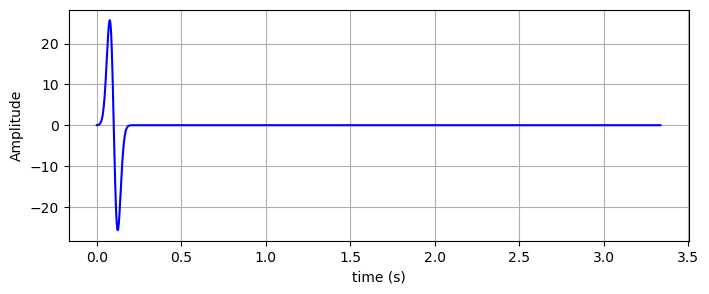

In [3]:
# Source time function parameters
pt = 20.0 * dt   # Gaussian width
t0 = 3.0 * pt    # time shift

# source time function (first derivative of Gaussian)
src = -2.0 / (pt**2) * (t - t0) * np.exp(- ((t - t0)**2) / (pt**2))

# spatial source vector (unit amplitude at index isx)
f = np.zeros(nx)
f[isx] = 1.0

# quick plot (static) to check source
plt.figure(figsize=(8,3))
plt.plot(t, src, color='b', lw=1.5)
plt.ylabel('Amplitude')
plt.xlabel('time (s)')
plt.grid(True)
plt.show()


### 3. The Mass Matrix
Having implemented the desired source, now we initialize the mass and stiffness matrices. In general, the mass matrix is given by

\begin{equation}
M_{ij} = \int_{D} \rho \varphi_i \varphi_j dx = \int_{D_{\xi}} \rho \varphi_i \varphi_j d\xi
\end{equation}

Next, the defined basis are introduced and some algebraic treatment is done to arrive at the explicit form of the mass matrix

\begin{equation}
M_{ij} = \frac{\rho h}{6}
 \begin{pmatrix}
   \ddots  &    &    &    & 0\\
   1 & 4 &  1 &    &  \\
     & 1 &  4 &  1 &  \\
     &   &  1 &  4 & 1\\
   0 &   &    &    &  \ddots
 \end{pmatrix}
\end{equation}

In [4]:
# Mass matrix (consistent mass assembly)
M = np.zeros((nx, nx), dtype=float)

# interior nodes
for i in range(1, nx-1):
    # diagonal contribution (from element left and element right)
    M[i, i] = (ro[i-1]*h[i-1] + ro[i]*h[i]) / 3.0
    # off-diagonals
    M[i, i-1] = ro[i-1]*h[i-1] / 6.0
    M[i, i+1] = ro[i]*h[i] / 6.0

# corners
M[0, 0] = ro[0]*h[0] / 3.0
M[0, 1] = ro[0]*h[0] / 6.0
M[-1, -1] = ro[-1]*h[-2] / 3.0
M[-1, -2] = ro[-1]*h[-2] / 6.0

# Avoid full matrix inverse for performance: use inverse of diagonal (lumped-ish)
# If you want exact, you can do Minv = np.linalg.inv(M) but it's costly for nx=1000.
Minv_diag = 1.0 / np.diag(M)   # shape (nx,)


### 4. The Stiffness matrix
The general form of the stiffness matrix is

\begin{equation}
K_{ij} = \int_{D} \mu \partial_x\varphi_i \partial_x\varphi_j dx = \int_{D_{\xi}} \mu \partial_\xi\varphi_i \partial_\xi\varphi_j d\xi
\end{equation}

After some algebraic treatment, we arrive at the explicit form of the stiffness matrix

\begin{equation}
K_{ij} = \frac{\mu}{h}
 \begin{pmatrix}
   \ddots  &    &    &    & 0\\
  -1 & 2 & -1 &    &  \\
     &-1 &  2 & -1 &  \\
     &   & -1 &  2 & -1\\
   0 &   &    &    &  \ddots
 \end{pmatrix}
\end{equation}


In [5]:
K = np.zeros((nx, nx), dtype=float)

# interior
for i in range(1, nx-1):
    K[i, i]   = mu[i-1]/h[i-1] + mu[i]/h[i]
    K[i, i-1] = -mu[i-1]/h[i-1]
    K[i, i+1] = -mu[i]/h[i]

# boundaries (Neumann / natural / consistent)
K[0,0] = mu[0]/h[0]
K[0,1] = -mu[0]/h[0]
K[-1,-1] = mu[-1]/h[-2]
K[-1,-2] = -mu[-1]/h[-2]


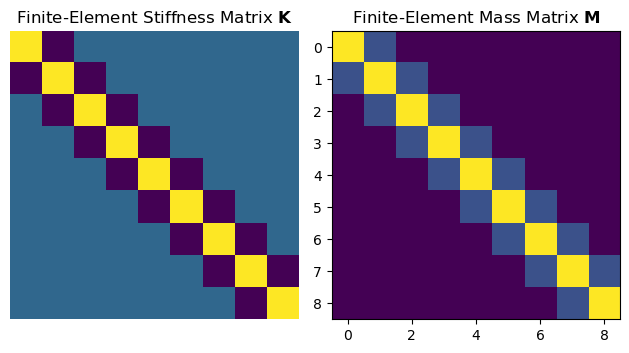

In [6]:
# Display finite element matrices
# ---------------------------------------------------------------
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(K[1:10,1:10])
ax1.set_title(r'Finite-Element Stiffness Matrix $\mathbf{K}$')
ax1.axis("off")

ax2.imshow(M[1:10,1:10])
ax2.set_title(r'Finite-Element Mass Matrix $\mathbf{M}$') # Displaying M, not M inverse

plt.tight_layout()
plt.show()

### 5. Finite differences matrices
We implement a finite difference scheme using matrix-vector operations in order to compare with the finite elements solution.

The classic 2nd derivative matrix (corresponding to the stiffness matrix in the finite-element scheme) can be initialized as

\begin{equation}
D_{ij} = \frac{\mu}{dx^2}
 \begin{pmatrix}
   -2 & 1  &    &    &  \\
    1 & -2 & 1  &    &  \\
      &  & \ddots  &  & \\
      &   & 1 &  -2 & 1\\
      &   &    &  1 & -2
 \end{pmatrix}
\end{equation}

To bring the finite-difference scheme formally to the same structure we also need the corresponding mass matrix simply using the inverse densities, we initialize with

\begin{equation}
M^{fd}_{ij} =
 \begin{pmatrix}
   1/{\rho_1} &   &    &    &  \\
     &  1/{\rho_2} &  &    &  \\
      &  & \ddots  &  & \\
      &   &   &  1/{\rho_{N-1}}  & \\
      &   &    &   & 1/{\rho_{N}}
 \end{pmatrix}
\end{equation}


In [7]:
# Finite difference mass (diagonal) and second derivative operator D
Mfd = np.zeros((nx, nx), dtype=float)
D = np.zeros((nx, nx), dtype=float)

for i in range(nx):
    Mfd[i, i] = 1.0 / ro[i]

for i in range(1, nx-1):
    D[i, i] = -2.0
    D[i, i-1] = 1.0
    D[i, i+1] = 1.0

# scale D by mu/(dx^2). For uniform ro0 and vs we used: ro0*vs^2 * D / dx^2 in original.
# The correct scaling is mu/dx^2 with mu at nodes (we approximate here using ro0*vs^2)
D = ro0 * vs**2 * D / (dx**2)


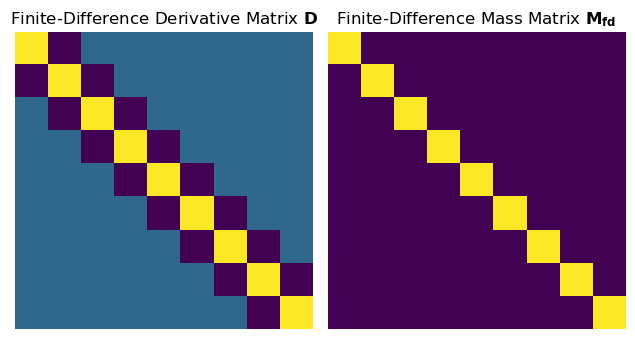

In [8]:
# Display differences matrices
# ---------------------------------------------------------------
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(-D[1:10,1:10])
ax1.set_title(r'Finite-Difference Derivative Matrix $\mathbf{D}$')
ax1.axis("off")

ax2.imshow(Mfd[1:10,1:10])
ax2.set_title(r'Finite-Difference Mass Matrix $\mathbf{M_{fd}}$')
ax2.axis("off")

plt.tight_layout()
plt.show()

### 6. Finite element solution

Finally we implement the finite element solution using the computed mass $M$ and stiffness $K$ matrices together with a finite differences extrapolation scheme

\begin{equation}
\mathbf{u}(t + dt) = dt^2 (\mathbf{M}^T)^{-1}[\mathbf{f} - \mathbf{K}^T\mathbf{u}] + 2\mathbf{u} - \mathbf{u}(t-dt).
\end{equation}

Animation size has reached 20975692 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


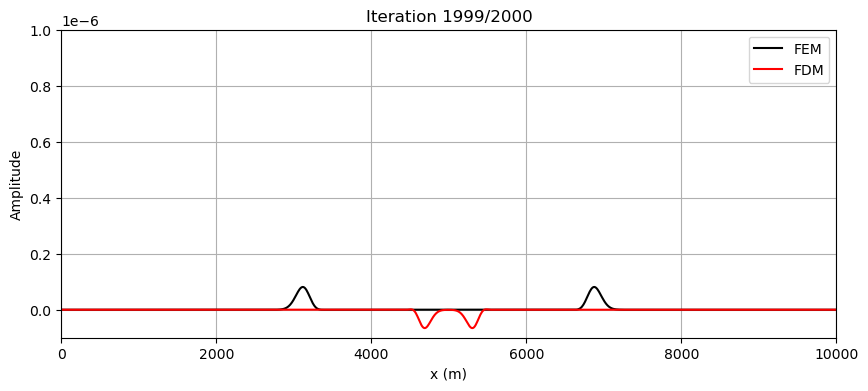

In [9]:
# --- Initialize solution arrays ---
u    = np.zeros(nx)   # FEM displacement (current)
uold = np.zeros(nx)   # FEM previous
unew = np.zeros(nx)

p    = np.zeros(nx)   # FDM displacement (current)
pold = np.zeros(nx)   # FDM previous
pnew = np.zeros(nx)

# initialize BCs (free-surface / zero traction? keep as zeros here)
# if needed set boundary conditions by adjusting K or forcing

# --- Prepare figure ---
fig, ax = plt.subplots(figsize=(10,4))
line_fem, = ax.plot(x, u, 'k-', lw=1.5, label='FEM')
line_fdm, = ax.plot(x, p, 'r-', lw=1.5, label='FDM')
ax.set_xlim(0, xmax)
ax.set_ylim(-0.001, 0.001 + np.max(np.abs(u)) + 1e-6)  # auto y-scale may be updated in init
ax.set_title('Finite elements 1D Animation')
ax.set_xlabel('x (m)')
ax.set_ylabel('Amplitude')
ax.legend()
ax.grid(True)

# For stable animation we can compute a small expected amplitude and set y-limits:
ax.set_ylim(-1e-7, 1e-6)

# --- time stepping update function ---
def step(it):
    global u, uold, unew, p, pold, pnew

    # --- FEM update (explicit) ---
    rhs_fem = f * src[it] - K.dot(u)          # RHS vector
    unew = (dt**2) * (Minv_diag * rhs_fem) + 2.0*u - uold   # elementwise Minv_diag * rhs
    uold, u = u, unew

    # --- FDM update ---
    rhs_fdm = (f * src[it]) / dx + D.dot(p)   # keep structure similar to your original
    pnew = (dt**2) * (Mfd.dot(rhs_fdm)) + 2.0*p - pold
    pold, p = p, pnew

    # update lines
    line_fem.set_data(x, u)
    line_fdm.set_data(x, p)

    # optional: update y-limits adaptively (commented out to keep stable)
    # ymax = 1.2 * max(np.max(np.abs(u)), np.max(np.abs(p)) , 1e-6)
    # ax.set_ylim(-ymax, ymax)

    ax.set_title(f'Iteration {it}/{nt}', fontsize=12)
    return line_fem, line_fdm

# --- Create animation (colab-friendly) ---
ani = FuncAnimation(fig, step, frames=nt, interval=30, blit=True)

# Display inline in Colab
HTML(ani.to_jshtml())
